# Lecture : Graph-based Visualization

## Lab 04 : Laplacian Eigenmaps 

### Xavier Bresson  


In [1]:
# For Google Colaboratory
import sys, os
if 'google.colab' in sys.modules:
    # mount google drive
    from google.colab import drive
    drive.mount('/content/gdrive')
    path_to_file = '/content/gdrive/My Drive/CS5284_2024_codes/codes/06_Visualization'
    print(path_to_file)
    # change current path to the folder containing "path_to_file"
    os.chdir(path_to_file)
    !pwd
    

In [2]:
# Load libraries
import numpy as np
import scipy.io
from matplotlib import pyplot
import matplotlib.pyplot as plt
import time
import sys; sys.path.insert(0, 'lib/')
import scipy.sparse.linalg
# import scipy.ndimage
from lib.utils import compute_pca, construct_knn_graph, nldr_visualization
import warnings; warnings.filterwarnings("ignore")
import torch


# PCA for MNIST

In [3]:
# MNIST dataset
mat = scipy.io.loadmat('datasets/MNIST_data.mat')
X = Xnumpy = mat['X']
n = X.shape[0]
d = X.shape[1]
C = mat['C'].squeeze()
print(n,d)

# extract a subset of data points
# idx_rand = torch.randperm(n)[:10000]; X = X[idx_rand,:]; C = C[idx_rand]; print(X.shape,C.shape)


60000 784


nb_pca: 3


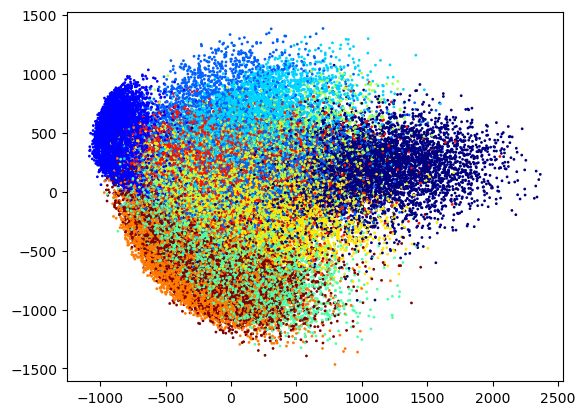

In [4]:
# PCA
nb_pca = 3
[PC,PD,EnPD] = compute_pca(X,nb_pca)
Xvis = PC[:,0]
Yvis = PC[:,1]
Zvis = PC[:,2]

# 2D Visualization
plt.figure(3)
plt.scatter(Xvis, Yvis, c=C, s=1, color=pyplot.jet())
plt.show()


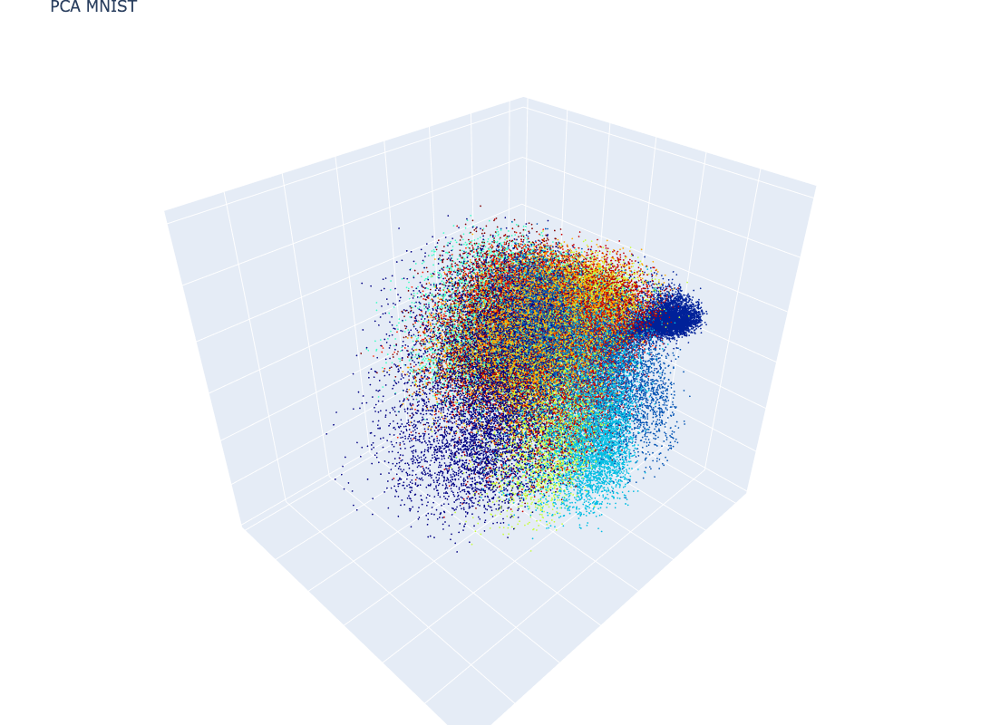

In [5]:
# 3D Visualization
import plotly.graph_objects as go
data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1)) # data as points
# data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1, showscale=True)) # w/ colobar 
fig = go.Figure(data=[data]) 
fig.update_layout(margin=dict(l=0, r=0, b=0, t=25, pad=0)) # tight layout but t=25 required for showing title 
fig.update_layout(autosize=False, width=800, height=800, title_text="PCA MNIST") # figure size and title
# fig.update_layout(scene = dict(xaxis = dict(visible=False), yaxis = dict(visible=False), zaxis = dict(visible=False))) # no grid, no axis 
# fig.update_layout(scene = dict(xaxis_title = ' ', yaxis_title = ' ', zaxis_title = ' ')) # no axis name 
fig.update_layout(scene = dict(zaxis = dict(showgrid = True, showticklabels = False), zaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(yaxis = dict(showgrid = True, showticklabels = False), yaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(xaxis = dict(showgrid = True, showticklabels = False), xaxis_title = ' ') ) # no range values, no axis name, grid on
fig.show()


# LapEigMap for MNIST

batch_size 2000
Convert from numpy to pytorch
k-NN graph construction with euclidean distance
n, batch_size, num_batch, kNN, device: 60000 2000 30 10 cpu
batch idx: 1 / 30  time(sec): 5.898289918899536
batch idx: 2 / 30  time(sec): 8.760969877243042
batch idx: 3 / 30  time(sec): 12.128622055053711
batch idx: 4 / 30  time(sec): 16.096333026885986
batch idx: 5 / 30  time(sec): 21.065922021865845
batch idx: 6 / 30  time(sec): 24.130801916122437
batch idx: 7 / 30  time(sec): 27.051729202270508
batch idx: 8 / 30  time(sec): 29.899739027023315
batch idx: 9 / 30  time(sec): 32.76406812667847
batch idx: 10 / 30  time(sec): 35.60040283203125
batch idx: 11 / 30  time(sec): 38.94513511657715
batch idx: 12 / 30  time(sec): 42.90524888038635
batch idx: 13 / 30  time(sec): 45.939634799957275
batch idx: 14 / 30  time(sec): 49.6571569442749
batch idx: 15 / 30  time(sec): 52.61656904220581
batch idx: 16 / 30  time(sec): 55.42152500152588
batch idx: 17 / 30  time(sec): 59.17451095581055
batch idx: 18 / 

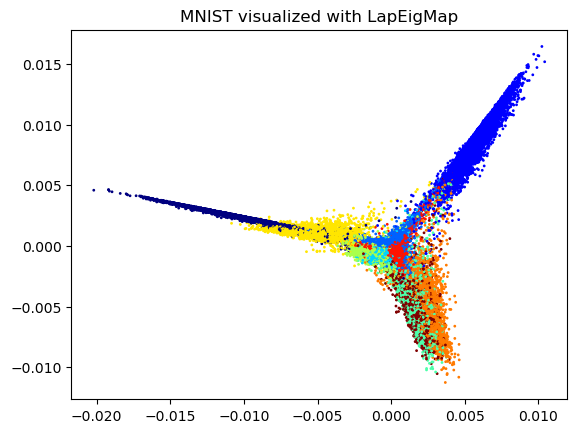

In [6]:
# Compute a k-NN graph
kNN = 10
dist = 'euclidean'
W = construct_knn_graph(X, kNN, dist)
#print(W)

# Laplacian Eigenmaps
start = time.time()
Xvis,Yvis,Zvis = nldr_visualization(W)
print('time(sec):',(time.time()-start)/1)

# 2D Visualization
plt.figure(3)
plt.scatter(Xvis, Yvis, c=C, s=1, color=pyplot.jet())
plt.title('MNIST visualized with LapEigMap') 
plt.show()


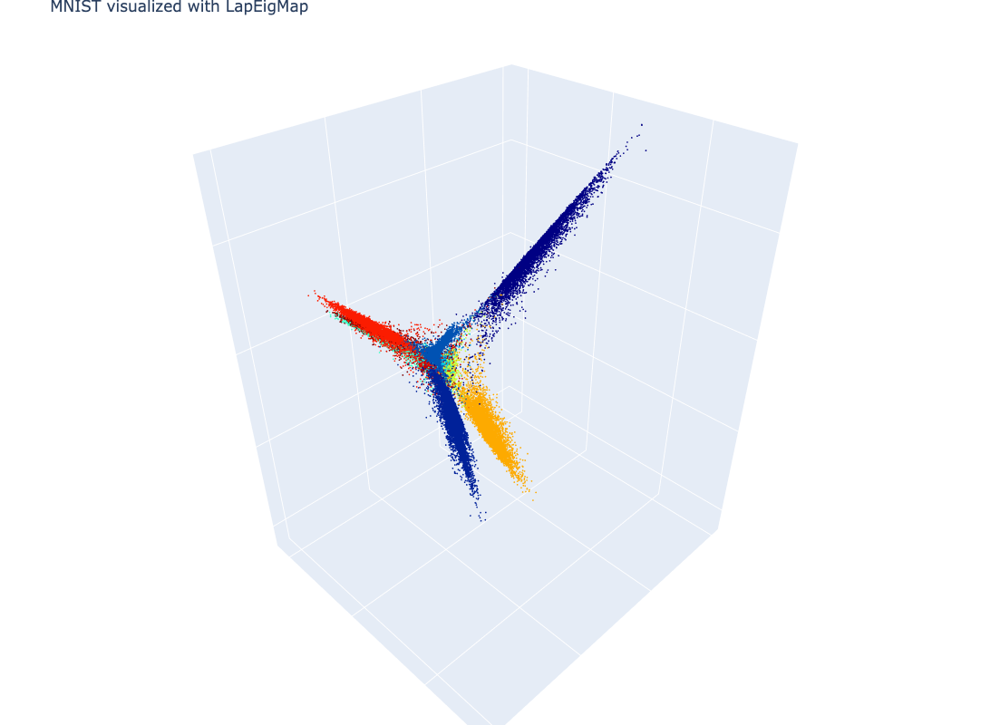

In [7]:
# 3D Visualization
import plotly.graph_objects as go
data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1)) # data as points
# data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1, showscale=True)) # w/ colobar 
fig = go.Figure(data=[data]) 
fig.update_layout(margin=dict(l=0, r=0, b=0, t=25, pad=0)) # tight layout but t=25 required for showing title 
fig.update_layout(autosize=False, width=800, height=800, title_text="MNIST visualized with LapEigMap") # figure size and title
# fig.update_layout(scene = dict(xaxis = dict(visible=False), yaxis = dict(visible=False), zaxis = dict(visible=False))) # no grid, no axis 
# fig.update_layout(scene = dict(xaxis_title = ' ', yaxis_title = ' ', zaxis_title = ' ')) # no axis name 
fig.update_layout(scene = dict(zaxis = dict(showgrid = True, showticklabels = False), zaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(yaxis = dict(showgrid = True, showticklabels = False), yaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(xaxis = dict(showgrid = True, showticklabels = False), xaxis_title = ' ') ) # no range values, no axis name, grid on
fig.show()
